* Usage of word over time


In [15]:
%run './model/corpus.py'

import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

sns.set(rc = {'figure.figsize':(15,8)})

In [16]:
corpus = Corpus("../output/df.parquet")

 Nodes: 34263 
 Edges: 386744 
 Shape: (34214, 14) 


In [4]:
corpus.citation_df.head()

Areas,AuthorKeywords,Abstract,Title,Journal,Doi,WosKeywords,Category,Authors,Date,Text,References,Community,InCentrality
list[str],list[str],str,str,str,str,list[str],list[str],list[str],datetime[μs],str,list[str],i32,f32
"[""sociology""]",null,"""recently, ther...","""rankings and r...","""american journ...","""10.1086/517897...","[""statistics"", "" numbers""]","[""sociology""]","[""espeland, wn"", "" sauder, m""]",2007-07-01 00:00:00,"""rank reactiv p...","[""10.2307/2393938"", ""10.1177/000312240406900203"", ""10.1086/374404""]",2,0.002247
"[""business & economics""]",null,"""this research ...","""members' respo...","""administrative...","""10.2307/239393...","[""intergroup bias"", "" identification"", ... "" image""]","[""business"", "" management""]","[""elsbach, kd"", "" kramer, rm""]",1996-09-01 00:00:00,"""member respons...","[""10.2307/258189"", ""10.2307/2393235"", ... ""10.2307/256007""]",2,0.004115
"[""sociology""]",null,"""drawing on int...","""what is origin...","""american socio...","""10.1177/000312...","[""stands today"", "" journals"", "" self""]","[""sociology""]","[""guetzkow, j"", "" lamont, m"", "" mallard, g""]",2004-04-01 00:00:00,"""origin human s...","[""10.2307/2095599"", ""10.1086/225431"", ""10.2307/2094272""]",3,0.000233
"[""sociology""]",null,"""this analysis ...","""constructing a...","""american journ...","""10.1086/374404...","[""option prices"", "" efficiency"", "" tests""]","[""sociology""]","[""mackenzie, d"", "" millo, y""]",2003-07-01 00:00:00,"""construct mark...","[""10.1086/227944"", ""10.1086/229739"", ""10.1086/228311""]",2,0.00108
"[""sociology""]",null,"""debates on how...","""the paradox of...","""american socio...","""10.2307/265733...","[""capitalist democracies"", "" social rights"", ... "" gender""]","[""sociology""]","[""korpi, w"", "" palme, j""]",1998-10-01 00:00:00,"""paradox redist...","[""10.1086/230320"", ""10.1086/230321"", ... ""10.2307/2096358""]",3,0.000496


In [6]:
corpus.citation_df.null_count()

Areas,AuthorKeywords,Abstract,Title,Journal,Doi,WosKeywords,Category,Authors,Date,Text,References,Community,InCentrality
u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32
0,12115,5390,0,0,0,7426,0,0,0,0,850,0,0


In [ ]:
from networkx.algorithms import community # louvain_communities, louvain_partitions, girvan_newman

comp = community.girvan_newman(G)
list(comp)

In [22]:
from collections import defaultdict

from networkx.algorithms import community # louvain_communities, louvain_partitions, girvan_newman
# import community as louvain_community

nodes = corpus.most_referenced(100).get_column('Doi').to_list()
G = corpus.citation_graph.subgraph(nodes)
nodes = max(nx.weakly_connected_components(G), key=len)
G = G.subgraph(nodes)
print(f'Nodes: {len(G.nodes())}\nEdges: {len(G.edges())}')

levels = list(community.girvan_newman(G))

levels = levels[20:23]

Nodes: 97
Edges: 341


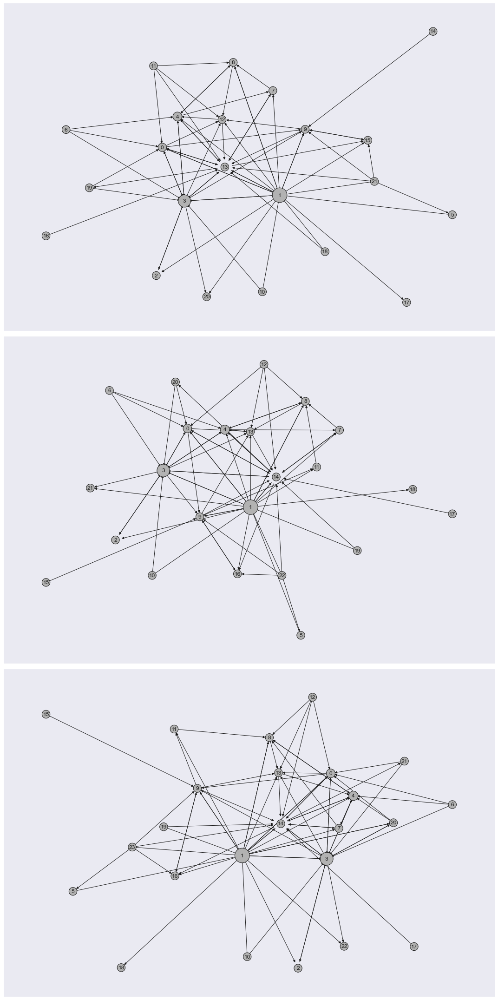

In [11]:
fig = plt.figure(figsize=(15, 10*len(levels)))
axes = fig.subplots(len(levels), 1)
min_node_size = 300
node_size_factor = 1000
min_edge_size = 1
edge_size_factor = 1


for (i, level) in enumerate(levels):

    belonging = {doc: c for (c, comm) in enumerate(level) for doc in comm}

    weighted_edges = defaultdict(int)
    for u, v in G.edges():
        weighted_edges[(belonging[u], belonging[v])] += 1

    edge_list = list(weighted_edges.keys())
    edge_width = [max(v / max(weighted_edges.values()) * edge_size_factor, min_edge_size) for v in weighted_edges.values()]

    nodes = defaultdict(list)
    for (doc, c) in belonging.items():
        nodes[c].append(doc)

    node_list = list(nodes.keys())
    node_size = [float(max(len(v) / len(max(nodes.values(), key=len)) * node_size_factor, min_node_size)) for v in nodes.values()]

    G_comms = nx.DiGraph()
    G_comms.add_weighted_edges_from([(u, v, w) for ((u, v), w) in weighted_edges.items() if (u != v)])

    pos = nx.nx_pydot.graphviz_layout(G_comms, prog="sfdp") # dot, twopi, fdp, sfdp, circo
            
    nodes_with_term = nx.draw_networkx_nodes(
        G_comms, 
        pos, 
        nodelist=node_list,
        node_size=node_size,
        node_color='#B2B2B2',
        node_shape='o',
        alpha=None,
        ax=axes[i],
        linewidths=1, 
        edgecolors='k', 
        label=level, 
        margins=None,
    )
    nodes_with_term.set_zorder(1)

    nx.draw_networkx_labels(G_comms, pos, labels=dict(zip(nodes.keys(), nodes.keys())), font_size=12, font_color='k', font_family='sans-serif', font_weight='normal', alpha=1.0, bbox=None, ax=axes[i])

    edge_collection = nx.draw_networkx_edges(
        G_comms, 
        pos,
        edgelist=None,
        width=edge_width,
        edge_color='k',
        style='solid',
        alpha=None,
        arrowstyle=None,
        arrowsize=10,
        edge_cmap=None,
        edge_vmin=None,
        edge_vmax=None,
        ax=axes[i],
        arrows=None,
        label=None,
        node_size=dict(zip(node_list, node_size)),
        nodelist=None,
        node_shape='o',
        connectionstyle='arc3',
    )

    for c in edge_collection:
        c.set_zorder(-1)

    # lgnd = axes[i].legend(loc="upper right", scatterpoints=1, fontsize=10)
    # lgnd.legendHandles[0]._sizes = [min_node_size/2]
    axes[i].grid(False)

fig.tight_layout()
plt.show()

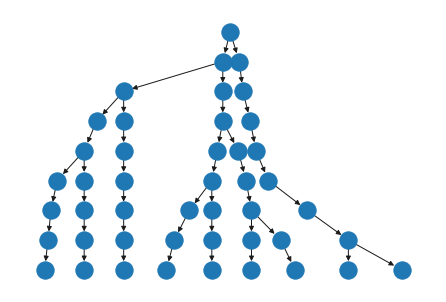

In [158]:
nodes = corpus.most_referenced(15).get_column('Doi').to_list()
G = corpus.citation_graph.subgraph(nodes)
nodes = max(nx.weakly_connected_components(G), key=len)
G = G.subgraph(nodes)

levels = list(community.girvan_newman(G))

d = defaultdict(dict)
id = 1
for (l, level) in enumerate(levels):
    temp = dict()
    for (c, comm) in enumerate(level):
        sorted_comm = tuple(sorted(comm))
        temp[sorted_comm] = id
        id += 1
    d[l] = temp

last = len(levels)-1
edges = []
for (l, level) in enumerate(levels):
    if not l:
        for child_comm in level:
            sorted_child_comm = tuple(sorted(child_comm))
            edges.append((0, d[l][sorted_child_comm]))
        continue

    if l == last:
        for child_comm in level:
            sorted_child_comm = tuple(sorted(child_comm))
            parent_comm = next(filter(lambda parent_comm: child_comm.issubset(parent_comm), levels[l-1]))
            sorted_parent_comm = tuple(sorted(parent_comm))
            edges.append((d[l-1][sorted_parent_comm], sorted_child_comm))
        break

    for child_comm in level:
        parent_comm = next(filter(lambda parent_comm: child_comm.issubset(parent_comm), levels[l-1]))
        sorted_parent_comm = tuple(sorted(parent_comm))
        sorted_child_comm = tuple(sorted(child_comm))
        edges.append((d[l-1][sorted_parent_comm], d[l][sorted_child_comm]))

G_dendo = nx.DiGraph()
G_dendo.add_edges_from(edges)

pos = nx.nx_pydot.graphviz_layout(G_dendo, prog="dot") # dot, twopi, fdp, sfdp, circo
nx.draw(G_dendo, pos=pos)

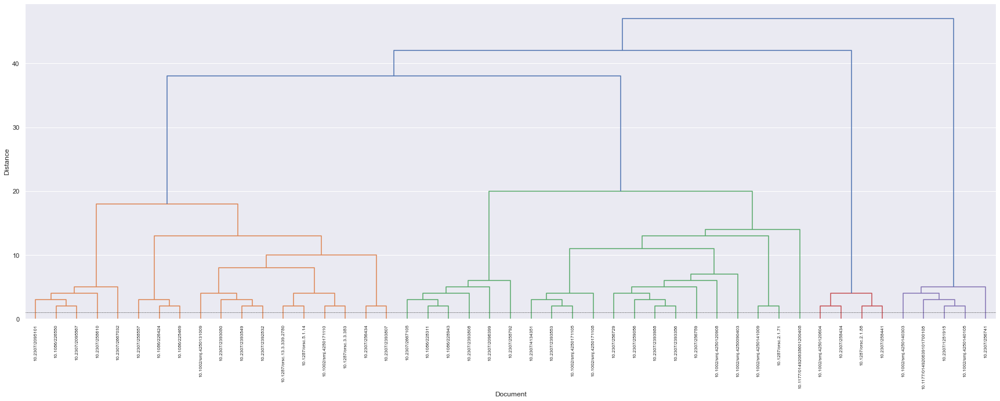

In [346]:
nodes = corpus.most_referenced(50).get_column('Doi').to_list()
G = corpus.citation_graph.subgraph(nodes)
nodes = max(nx.weakly_connected_components(G), key=len)
G = G.subgraph(nodes)

levels = list(community.girvan_newman(G))
levels.insert(0, (set(nodes),))

comm_ids = defaultdict(dict)
id = 0
for (l, level) in enumerate(levels):
    temp = dict()
    for (c, comm) in enumerate(level):
        sorted_comm = tuple(sorted(comm))
        temp[sorted_comm] = id
        id += 1
    comm_ids[l] = temp

last = len(levels)-1
edges = []
leaf_map = {}

for (l, level) in enumerate(levels[1:]):

    current_level = l + 1
    previous_level = l

    for child_comm in level:

        parent_comm = next(filter(lambda parent_comm: child_comm.issubset(parent_comm), levels[l]))
        sorted_parent_comm = tuple(sorted(parent_comm))
        sorted_child_comm = tuple(sorted(child_comm))

        parent_comm_id = comm_ids[previous_level][sorted_parent_comm]
        child_comm_id = comm_ids[current_level][sorted_child_comm]

        edges.append((parent_comm_id, child_comm_id))

        if current_level == last:    
            leaf_map[child_comm_id] = next(iter(child_comm))

G_dendo = nx.DiGraph()
G_dendo.add_edges_from(edges)

d = nx.to_dict_of_lists(G_dendo, nodelist=None)

G           = nx.DiGraph(d)
nodes       = G.nodes()
leaves      = set( n for n in nodes if G.out_degree(n) == 0 )
inner_nodes = [ n for n in nodes if G.out_degree(n) > 0 ]

subtree = dict( (n, [n]) for n in leaves )
for u in inner_nodes:
    children = set()
    node_list = list(d[u])
    while len(node_list) > 0:
        v = node_list.pop(0)
        children.add( v )
        node_list += d[v]

    subtree[u] = sorted(children & leaves)

inner_nodes.sort(key=lambda n: len(subtree[n]))

leaves = sorted(leaves)
index  = dict( (tuple([n]), i) for i, n in enumerate(leaves) )
Z = []
k = len(leaves)
for i, n in enumerate(inner_nodes):
    children = d[n]
    x = children[0]
    for y in children[1:]:
        z = tuple(sorted(subtree[x] + subtree[y]))
        i, j = index[tuple(subtree[x])], index[tuple(subtree[y])]
        Z.append([i, j, float(len(subtree[n])), len(z)])
        index[z] = k
        subtree[z] = list(z)
        x = z
        k += 1

leaves = [leaf_map[l] for l in leaves]

fig = plt.figure(figsize=(30, 10))
axes = fig.subplots(1)
plt.title('')
plt.xlabel('Document')
plt.ylabel('Distance')
dendrogram(Z, labels=leaves)
axes.yaxis.grid(True)
axes.xaxis.grid(False)
plt.axhline(y=1.0, c='k', ls='--', lw=0.5)
plt.show()

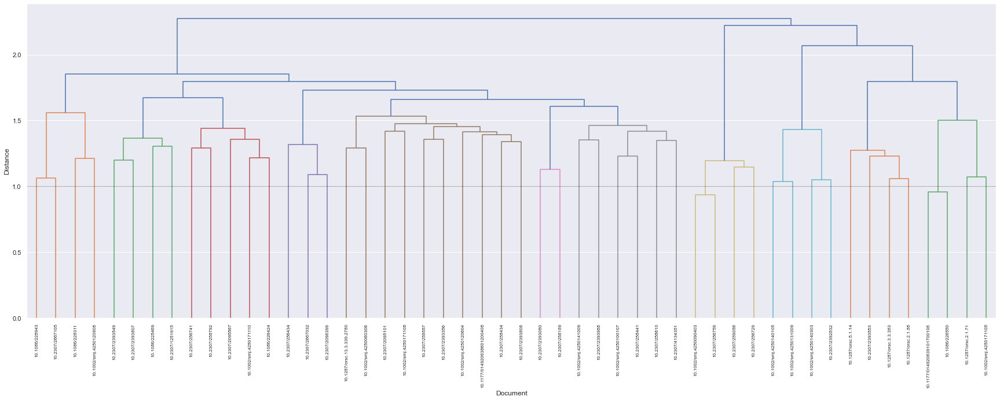

In [20]:
G = corpus.citation_graph

dois = list(G.nodes())
m = nx.to_numpy_matrix(G, weight=None)

documents = corpus.most_referenced(50)
document_dois = documents.get_column('Doi').to_list()

indices = [dois.index(doi) for doi in document_dois]
m = tv_matrix[indices]

similarity = cosine_similarity(m).round(decimals=3, out=None)

Z = linkage(similarity, 'ward')

fig = plt.figure(figsize=(30, 10))
axes = fig.subplots(1)
plt.title('')
plt.xlabel('Document')
plt.ylabel('Distance')
dendrogram(Z, labels=document_dois)
axes.yaxis.grid(True)
axes.xaxis.grid(False)
plt.axhline(y=1.0, c='k', ls='--', lw=0.5)

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


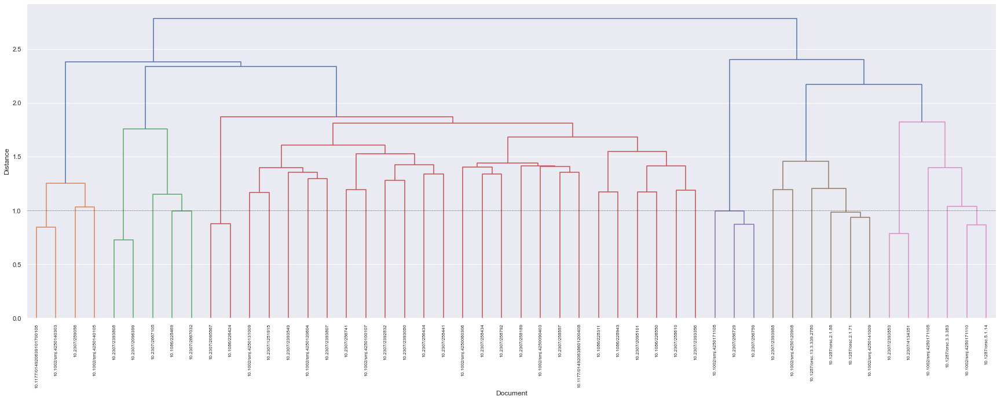

In [348]:
from sklearn.feature_extraction.text import TfidfTransformer, TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.pipeline import Pipeline
import numpy as np
from sklearn.metrics.pairwise import manhattan_distances, euclidean_distances, cosine_similarity
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster

df = corpus.citation_df
 
dois = df.get_column('Doi').to_list()
corpus_ = df.get_column('Text').to_list()

tv = TfidfVectorizer(min_df=0.,
                     max_df=1.,
                     norm='l2',
                     use_idf=True,
                     smooth_idf=True)

tv_matrix = tv.fit_transform(corpus_)
tv_matrix = tv_matrix.toarray()

vocab = tv.get_feature_names()

documents = corpus.most_referenced(50)
document_dois = documents.get_column('Doi').to_list()
document_texts = documents.get_column('Text').to_list()

indices = [dois.index(doi) for doi in document_dois]
m = tv_matrix[indices]

similarity = cosine_similarity(m).round(decimals=3, out=None)

Z = linkage(similarity, 'ward')

fig = plt.figure(figsize=(30, 10))
axes = fig.subplots(1)
plt.title('')
plt.xlabel('Document')
plt.ylabel('Distance')
dendrogram(Z, labels=document_dois)
axes.yaxis.grid(True)
axes.xaxis.grid(False)
plt.axhline(y=1.0, c='k', ls='--', lw=0.5)

In [353]:
max_d = 1
clusters = fcluster(Z, max_d, criterion='distance')
nodes = dict(zip(document_dois, clusters))

len(set(nodes.values()))


40

1


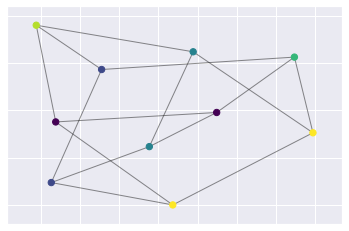

In [382]:

import matplotlib.cm as cm
import matplotlib.pyplot as plt
import networkx as nx

nodes = corpus.most_referenced(50).get_column('Doi').to_list()
G = corpus.citation_graph.subgraph(nodes)
nodes = max(nx.weakly_connected_components(G), key=len)
G = G.subgraph(nodes)
G = nx.petersen_graph()

pos = nx.spring_layout(G)

levels = list(community.louvain_partitions(G, weight=None, resolution=2, threshold=1e-07, seed=None))
print(len(levels))
for level in levels:
    partition = {node: p for (p, partition) in enumerate(level) for node in partition}

    cmap = cm.get_cmap('viridis', len(partition))
    nx.draw_networkx_nodes(G, pos, partition.keys(), node_size=40,
                        cmap=cmap, node_color=list(partition.values()))
    nx.draw_networkx_edges(G, pos, alpha=0.5)
    plt.show()

In [642]:
from nltk.stem import PorterStemmer

word = 'ecology'
stemmer = PorterStemmer()
stemmer.stem(word)

'ecolog'

In [638]:
nodes = corpus.most_referenced(200).get_column("Doi").to_list()
df = corpus.citation_df.filter(pl.col('Doi').is_in(nodes))
G = corpus.citation_graph.subgraph(nodes)

In [639]:
pos = nx.nx_pydot.graphviz_layout(G, prog="sfdp") # dot, twopi, fdp, sfdp, circo

In [523]:
n = len(G)
k = 1 / np.sqrt(n)
pos = nx.spring_layout(G, k=k, pos=None, fixed=None, iterations=50, threshold=0.0001, weight='weight', scale=1, center=None, dim=2, seed=None)

In [454]:
pos = nx.kamada_kawai_layout(G, dist=None, pos=None, weight='weight', scale=1, center=None, dim=2)

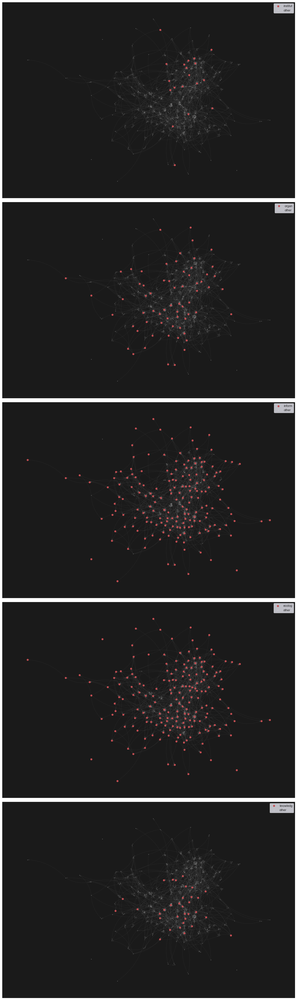

In [640]:
import matplotlib.patches as mpatches

terms = ["institut", "organ", "inform", "ecolog", "knowledg"]

fig = plt.figure(figsize=(15, 10*len(terms)))
axes = fig.subplots(len(terms), 1)

for (i, term) in enumerate(terms):

    groupby_contains_term = df.groupby(pl.col('Text').str.split(' ').arr.contains(term)).agg([pl.col('Doi')]).get_column('Doi').to_list()

    if len(groupby_contains_term) == 1:
        [without_term, with_term] = [[], groupby_contains_term[0]]
    elif len(groupby_contains_term) == 2:
        [without_term, with_term] = groupby_contains_term
    else:
        raise Exception
    
    nodes_with_term = nx.draw_networkx_nodes(
        G, 
        pos, 
        nodelist=with_term,
        node_size=50,
        node_color='r',
        node_shape='o',
        alpha=None,
        ax=axes[i],
        linewidths=0, 
        edgecolors='k', 
        label=f'{term}', 
        margins=None,
    )
    nodes_with_term.set_zorder(1)
    
    nodes_without_term = nx.draw_networkx_nodes(
        G, 
        pos,
        nodelist=without_term,
        node_size=5,
        node_color='w',
        node_shape='o',
        alpha=0.4,
        ax=axes[i],
        linewidths=0, 
        edgecolors='k', 
        label='other', 
        margins=None,
    )
    nodes_without_term.set_zorder(0)

    edge_collection = nx.draw_networkx_edges(
        G, 
        pos,
        edgelist=G.edges(),
        width=1.0,
        edge_color='w',
        style='solid',
        alpha=0.05,
        arrowstyle=None,
        arrowsize=10,
        ax=axes[i],
        node_size=5,
        node_shape='o',
        connectionstyle='arc3, rad=0.2',
    )

    for c in edge_collection:
        c.set_zorder(-1)

    axes[i].legend()
    axes[i].set_facecolor('k')
    axes[i].grid(False)

fig.tight_layout()
plt.show()

In [650]:
terms = ['ecolog', 'knowledg', 'race']

df = corpus.citation_df

fact = 10_000
min_node_size = 300

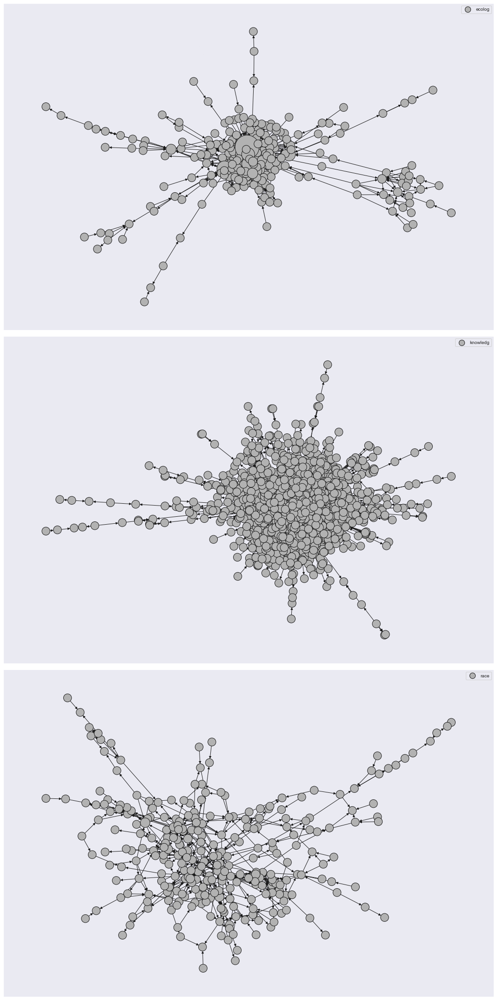

In [651]:
fig = plt.figure(figsize=(15, 10*len(terms)))
axes = fig.subplots(len(terms), 1)

for (i, term) in enumerate(terms):

    term_df = df.filter(pl.col('Text').str.split(' ').arr.contains(term))
    nodes = term_df.get_column('Doi').to_list()
    G_term = corpus.citation_graph.subgraph(nodes)
    G_term = G_term.subgraph(max(nx.weakly_connected_components(G_term), key=len))

    centrality = nx.in_degree_centrality(G_term)
    nodes = {n: max([c*fact, min_node_size]) for n, c in centrality.items()}

    pos = nx.nx_pydot.graphviz_layout(G_term, prog="sfdp") # dot, twopi, fdp, sfdp, circo
            
    nodes_with_term = nx.draw_networkx_nodes(
        G_term, 
        pos, 
        nodelist=list(nodes.keys()),
        node_size=list(nodes.values()),
        node_color='#B2B2B2',
        node_shape='o',
        alpha=None,
        ax=axes[i],
        linewidths=1, 
        edgecolors='k', 
        label=term, 
        margins=None,
    )
    nodes_with_term.set_zorder(1)

    edge_collection = nx.draw_networkx_edges(
        G_term, 
        pos,
        edgelist=None,
        width=1.0,
        edge_color='k',
        style='solid',
        alpha=None,
        arrowstyle=None,
        arrowsize=10,
        edge_cmap=None,
        edge_vmin=None,
        edge_vmax=None,
        ax=axes[i],
        arrows=None,
        label=None,
        node_size=list(nodes.values()),
        nodelist=None,
        node_shape='o',
        connectionstyle='arc3',
    )

    for c in edge_collection:
        c.set_zorder(-1)

    lgnd = axes[i].legend(loc="upper right", scatterpoints=1, fontsize=10)
    lgnd.legendHandles[0]._sizes = [min_node_size/2]
    axes[i].grid(False)

fig.tight_layout()
plt.show()

In [635]:
root = corpus.most_referenced(1).get_column('Doi').to_list()[0]

G = corpus.get_descendants(root)
nodes = list(G.nodes())

pos = nx.nx_pydot.graphviz_layout(G, prog="sfdp") # dot, twopi, fdp, sfdp, circo

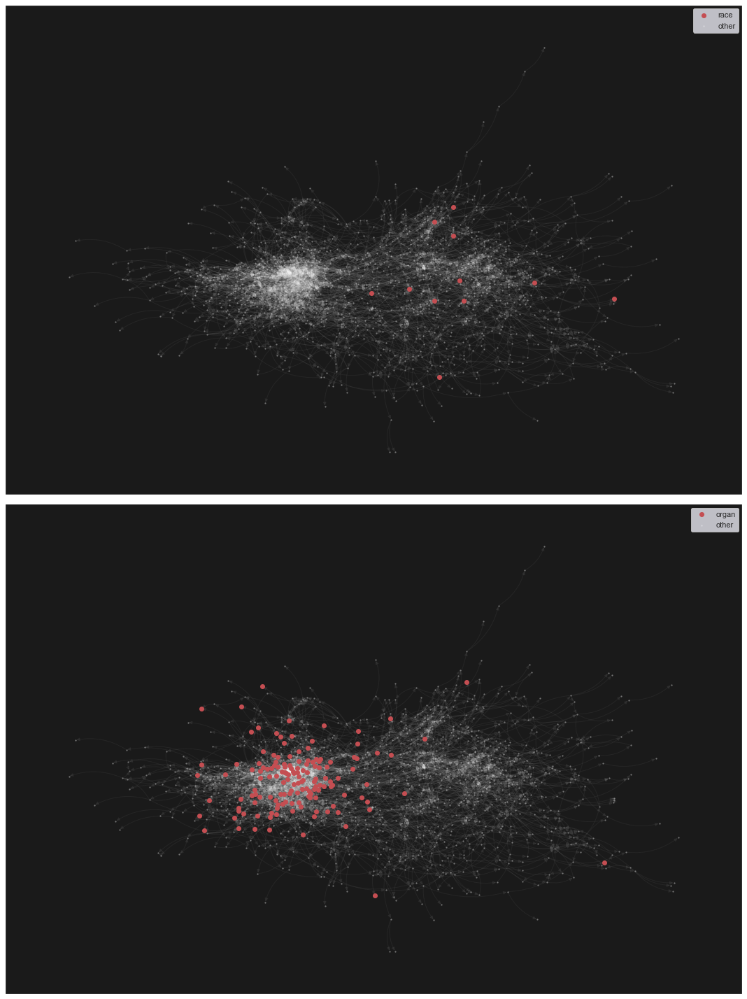

In [637]:
terms = ["race", "organ"] # , "inform", "ecolog", "knowledg"

df = corpus.citation_df
df = df.filter(pl.col('Doi').is_in(nodes))

fig = plt.figure(figsize=(15, 10*len(terms)))
axes = fig.subplots(len(terms), 1)

for (i, term) in enumerate(terms):

    groupby_contains_term = df.groupby(pl.col('Text').str.split(' ').arr.contains(term)).agg([pl.col('Doi')]).get_column('Doi').to_list()

    if len(groupby_contains_term) == 1:
        [without_term, with_term] = [[], groupby_contains_term[0]]
    elif len(groupby_contains_term) == 2:
        [without_term, with_term] = groupby_contains_term
    else:
        raise Exception
    
    nodes_with_term = nx.draw_networkx_nodes(
        G, 
        pos, 
        nodelist=with_term,
        node_size=50,
        node_color='r',
        node_shape='o',
        alpha=None,
        ax=axes[i],
        linewidths=0, 
        edgecolors='k', 
        label=f'{term}', 
        margins=None,
    )
    nodes_with_term.set_zorder(1)
    
    nodes_without_term = nx.draw_networkx_nodes(
        G, 
        pos,
        nodelist=without_term,
        node_size=5,
        node_color='w',
        node_shape='o',
        alpha=0.4,
        ax=axes[i],
        linewidths=0, 
        edgecolors='k', 
        label='other', 
        margins=None,
    )
    nodes_without_term.set_zorder(0)

    edge_collection = nx.draw_networkx_edges(
        G, 
        pos,
        edgelist=G.edges(),
        width=1.0,
        edge_color='w',
        style='solid',
        alpha=0.05,
        arrowstyle=None,
        arrowsize=10,
        ax=axes[i],
        node_size=5,
        node_shape='o',
        connectionstyle='arc3, rad=0.2',
    )

    for c in edge_collection:
        c.set_zorder(-1)

    axes[i].legend()
    axes[i].set_facecolor('k')
    axes[i].grid(False)

fig.tight_layout()
plt.show()

In [25]:

all_nodes = corpus.most_referenced(10000).get_column('Doi').to_list()
all_nodes = set(all_nodes)

G_all = corpus.citation_graph.subgraph(all_nodes)
G_all = nx.relabel_nodes(G_all, {n: f'"{n}"' for n in G_all.nodes()})

nodes_with_zoom = sub_df.collect().get_column('Doi').to_list()
nodes_with_zoom = set(nodes_with_zoom)

nodes_with_zoom = nodes_with_zoom & all_nodes
nodes_without_zoom = all_nodes - nodes_with_zoom

nodes_with_zoom = [f'"{n}"' for n in nodes_with_zoom]
nodes_without_zoom = [f'"{n}"' for n in nodes_without_zoom]

in_centrality = nx.in_degree_centrality(G_all)
sizes_without_zoom = [in_centrality[n]*100_000 if in_centrality[n] else 20 for n in nodes_without_zoom]
sizes_with_zoom = [in_centrality[n]*100_000 if in_centrality[n] else 20 for n in nodes_with_zoom]

In [26]:
pos = nx.nx_pydot.graphviz_layout(G_all, prog="sfdp") # dot, twopi, fdp, sfdp, circo

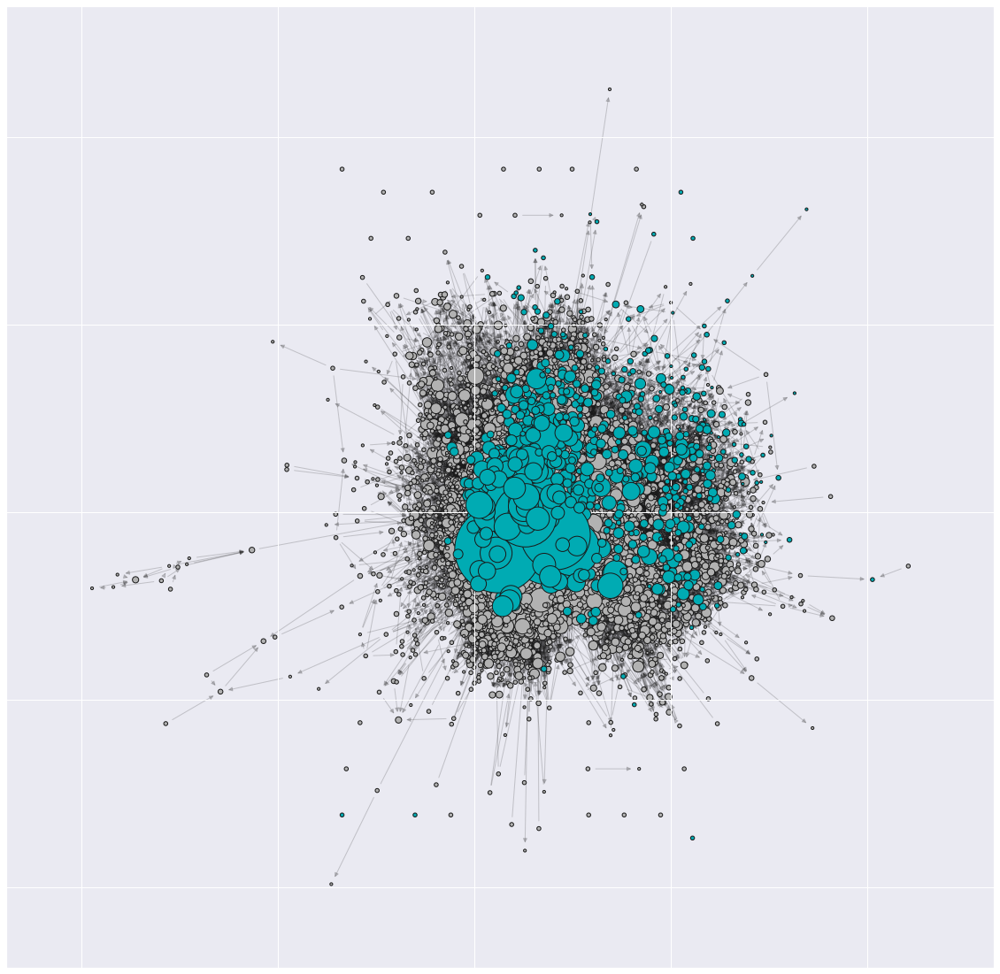

In [27]:
plt.figure(figsize=(20, 20))

nodes_with_zoom = nx.draw_networkx_nodes(
    G_all, 
    pos, 
    nodelist=nodes_with_zoom,
    node_size=sizes_with_zoom,
    node_color='#00ABB3',
    node_shape='o',
    alpha=None,
    cmap=None,
    vmin=None,
    vmax=None,
    ax=None,
    linewidths=1.0, 
    edgecolors='k', 
    label=None, 
    margins=None
)
nodes_with_zoom.set_zorder(1)

without_zoom_collection = nx.draw_networkx_nodes(
    G_all, 
    pos, 
    nodelist=nodes_without_zoom, 
    node_size=sizes_without_zoom, 
    node_color='#B2B2B2', 
    node_shape='o', 
    alpha=None, 
    cmap=None, 
    vmin=None, 
    vmax=None, 
    ax=None, 
    linewidths=1.0, 
    edgecolors='k', 
    label=None, 
    margins=None
)
without_zoom_collection.set_zorder(0)

edge_collection = nx.draw_networkx_edges(
    G_all, 
    pos,
    edgelist=G_all.edges(),
    width=1.0,
    edge_color='k',
    style='solid',
    alpha=0.2,
    arrowstyle=None,
    arrowsize=10,
    edge_cmap=None,
    edge_vmin=None,
    edge_vmax=None,
    ax=None,
    arrows=None,
    label=None,
    node_size=300,
    nodelist=None,
    node_shape='o',
    connectionstyle='arc3',
    min_source_margin=0,
    min_target_margin=0,
)

for c in edge_collection:
    c.set_zorder(-1)

# ax.grid(False)
plt.show()

In [277]:
root = corpus.most_referenced(1).get_column('Doi').to_list()[0]

n = 10
most_central = corpus.most_referenced(n)

G_genealogy = corpus.get_descendants(root)

shortest_paths = nx.shortest_path(G_genealogy, source=root, target=None, weight=None, method='dijkstra')

s = set()
for v in shortest_paths.values():
    for i in range(len(v)-1):
        s.add((v[i], v[i+1]))

G_genealogy = nx.DiGraph()
G_genealogy.add_edges_from(s)

In [278]:
term = "organiz"

sub_df = corpus.citation_df.lazy().filter(pl.col('Doi').is_in(list(G_genealogy.nodes())))
groups = sub_df.groupby(pl.col('Text').str.split(' ').arr.contains(term)).agg([pl.col('Doi'), pl.col("InCentrality")]).collect()

[nodes_without_term, nodes_with_term] = groups.get_column("Doi").to_list()
[sizes_without_term, sizes_with_term] = groups.get_column("InCentrality").to_list()

fact = 100_000
sizes_without_term = [s*fact if s*fact > 20 else 20 for s in sizes_without_term]
sizes_with_term = [s*fact if s*fact > 20 else 20 for s in sizes_with_term]

labels_without_term = [n if n in most_central else None for n in nodes_without_term]
labels_with_term = [n if n in most_central else None for n in nodes_without_term]

In [279]:
pos = nx.nx_pydot.graphviz_layout(G_genealogy, prog="twopi", root=root) # dot, twopi, fdp, sfdp, circo

In [275]:
pos = nx.nx_pydot.graphviz_layout(G_genealogy, prog="dot") # dot, twopi, fdp, sfdp, circo

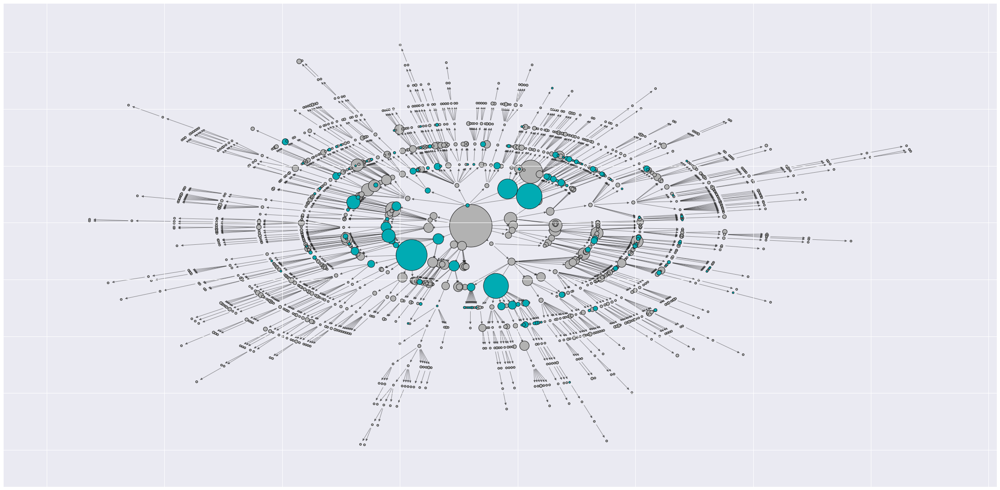

In [280]:
plt.figure(figsize=(20, 20))

nodes_with_term = nx.draw_networkx_nodes(
    G_genealogy, 
    pos, 
    nodelist=nodes_with_term,
    node_size=sizes_with_term,
    node_color='#00ABB3',
    node_shape='o',
    alpha=None,
    cmap=None,
    vmin=None,
    vmax=None,
    ax=None,
    linewidths=1.0, 
    edgecolors='k', 
    label=labels_with_term, 
    margins=None
)
nodes_with_term.set_zorder(1)

without_term_collection = nx.draw_networkx_nodes(
    G_genealogy, 
    pos, 
    nodelist=nodes_without_term, 
    node_size=sizes_without_term, 
    node_color='#B2B2B2', 
    node_shape='o', 
    alpha=None, 
    cmap=None, 
    vmin=None, 
    vmax=None, 
    ax=None, 
    linewidths=1.0, 
    edgecolors='k', 
    label=labels_without_term, 
    margins=None
)
without_term_collection.set_zorder(0)

edge_collection = nx.draw_networkx_edges(
    G_genealogy, 
    pos,
    edgelist=G_genealogy.edges(),
    width=1.0,
    edge_color='k',
    style='solid',
    alpha=0.5,
    arrowstyle=None,
    arrowsize=10,
    edge_cmap=None,
    edge_vmin=None,
    edge_vmax=None,
    ax=None,
    arrows=None,
    label=None,
    node_size=300,
    nodelist=None,
    node_shape='o',
    connectionstyle='arc3',
    min_source_margin=0,
    min_target_margin=0,
)

for c in edge_collection:
    c.set_zorder(-1)

# ax.grid(False)
plt.show()

In [375]:
all_nodes = corpus.most_referenced(5000).get_column('Doi').to_list()
G_all = corpus.citation_graph.subgraph(all_nodes)

n_communities = 5

palette = sns.color_palette("hls", n_communities).as_hex()

community_df = corpus.citation_df
communities = community_df.filter(pl.col('Doi').is_in(all_nodes)).groupby(pl.col('Community')).agg([pl.col('Doi'), pl.col('InCentrality')]).sort(pl.col('Community'))

communities_of_interest = communities[:n_communities]

other_nodes = communities[n_communities:].explode(['Doi', 'InCentrality'])
other_nodes_doi = other_nodes.get_column('Doi').to_list()
other_nodes_doi = [f'"{c}"' for c in other_nodes_doi]
other_nodes_centrality = other_nodes.get_column('InCentrality').to_list()

communities = communities_of_interest.get_column('Doi').to_list()
community_centralities = communities_of_interest.get_column('InCentrality').to_list()

G_all = nx.relabel_nodes(G_all, {n: f'"{n}"' for n in G_all.nodes()})

In [376]:
pos = nx.nx_pydot.graphviz_layout(G_all, prog="sfdp") # dot, twopi, fdp, sfdp, circo

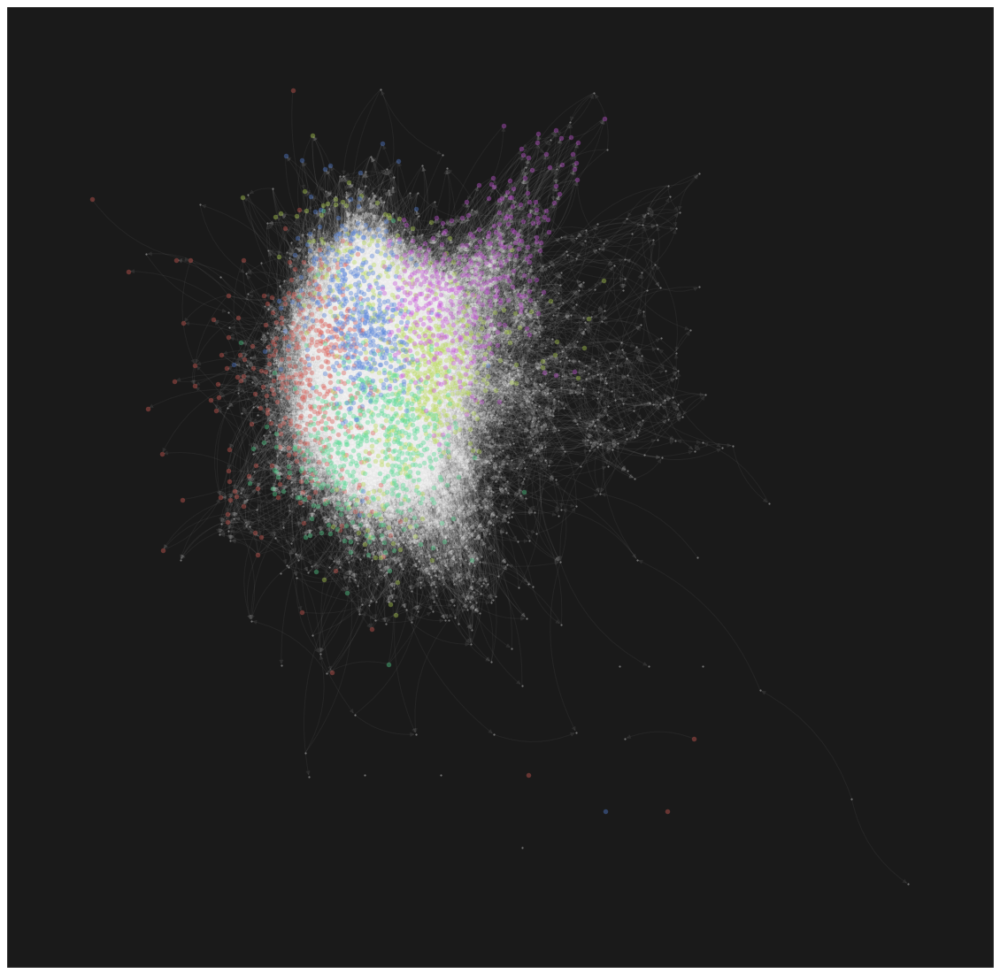

In [378]:
from re import X


plt.figure(figsize=(20, 20))

fact = 100_000

for (color, community, centralities) in zip(palette, communities, community_centralities):

    community = [f'"{c}"' for c in community]
    centralities = [c*fact if c*fact > 30 else 30 for c in centralities]

    community = nx.draw_networkx_nodes(
        G_all, 
        pos, 
        nodelist=community,
        node_size=30,
        node_color=color,
        node_shape='o',
        alpha=0.4,
        cmap=None,
        vmin=None,
        vmax=None,
        ax=None,
        linewidths=0, 
        edgecolors='k', 
        label=None,
        margins=None
    )
    community.set_zorder(1)

other_nodes_centrality = [c*fact if c*fact > 30 else 30 for c in other_nodes_centrality]

other_nodes = nx.draw_networkx_nodes(
    G_all, 
    pos, 
    nodelist=other_nodes_doi,
    node_size=5,
    node_color='w',
    node_shape='o',
    alpha=0.4,
    cmap=None,
    vmin=None,
    vmax=None,
    ax=None,
    linewidths=0, 
    edgecolors='k', 
    label=None,
    margins=None
)
other_nodes.set_zorder(0)


edge_collection = nx.draw_networkx_edges(
    G_all, 
    pos,
    edgelist=G_all.edges(),
    width=1.0,
    edge_color='w',
    style='solid',
    alpha=0.05,
    arrowstyle=None,
    arrowsize=10,
    edge_cmap=None,
    edge_vmin=None,
    edge_vmax=None,
    ax=None,
    arrows=None,
    label=None,
    node_size=5,
    nodelist=None,
    node_shape='o',
    connectionstyle='arc3, rad=0.2',
    min_source_margin=0,
    min_target_margin=0,
)

for c in edge_collection:
    c.set_zorder(-1)

plt.grid(False)
plt.gca().set_facecolor('k')
plt.show()

plt.show()

<AxesSubplot:>

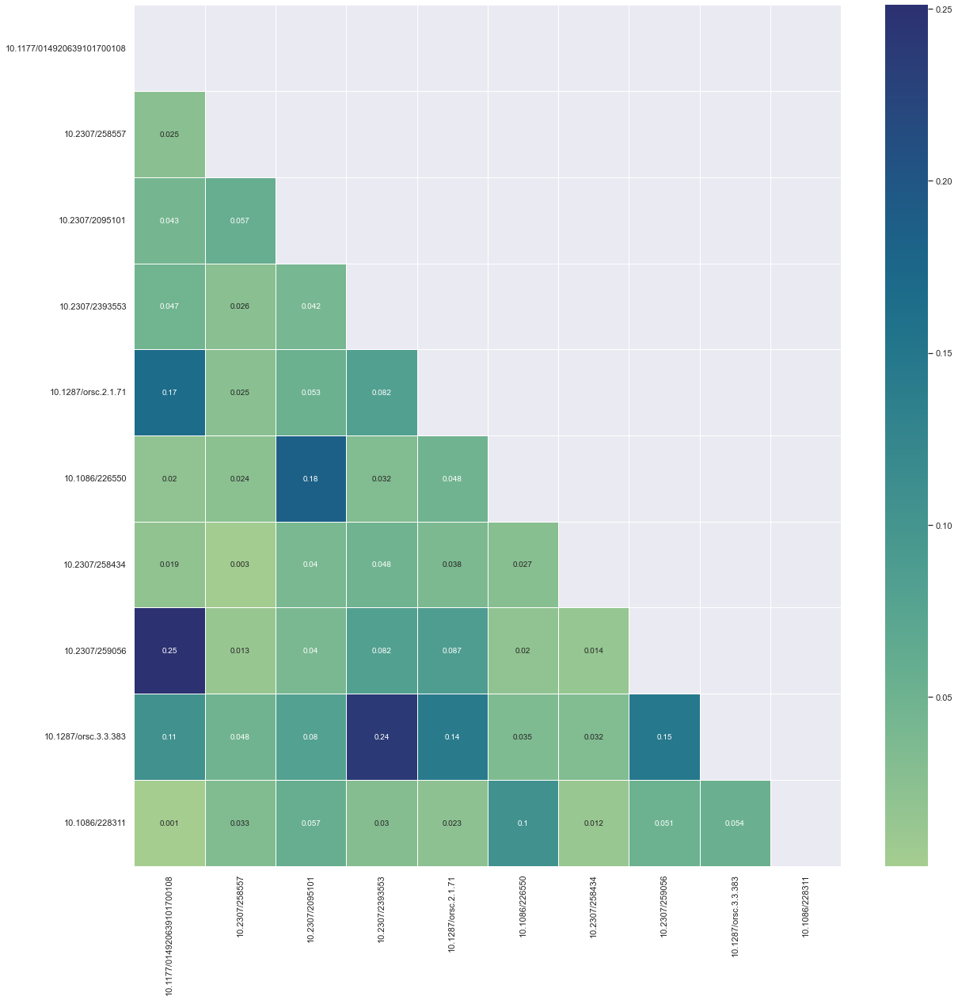

In [4]:
from sklearn.feature_extraction.text import TfidfTransformer, TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.pipeline import Pipeline
import numpy as np
from sklearn.metrics.pairwise import manhattan_distances, euclidean_distances, cosine_similarity

df = corpus.citation_df
 
dois = df.get_column('Doi').to_list()
corpus_ = df.get_column('Text').to_list()

tv = TfidfVectorizer(min_df=0.,
                     max_df=1.,
                     norm='l2',
                     use_idf=True,
                     smooth_idf=True)

tv_matrix = tv.fit_transform(corpus_)

tv_matrix = tv_matrix.toarray()

vocab = tv.get_feature_names()



most_referenced = corpus.most_referenced(10).get_column('Doi').to_list()
indices = [dois.index(doi) for doi in most_referenced]
m = tv_matrix[indices]

similarity = cosine_similarity(m).round(decimals=3, out=None)

mask = np.triu(similarity)

plt.figure(figsize=(20, 20))

sns.heatmap(similarity, annot=True, linewidth=.5, cmap="crest", xticklabels=most_referenced, yticklabels=most_referenced, mask=mask)

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


<AxesSubplot:>

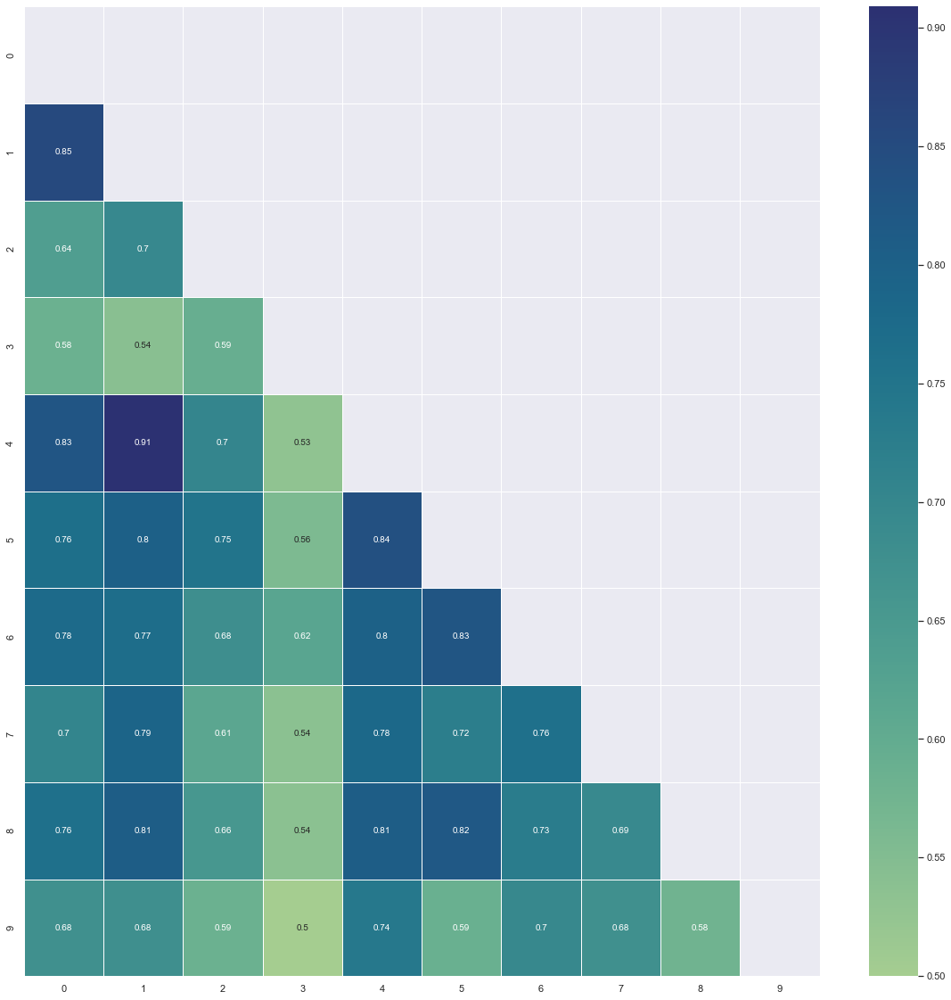

In [119]:
from sklearn.feature_extraction.text import TfidfTransformer, TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.pipeline import Pipeline
import numpy as np
from sklearn.metrics.pairwise import manhattan_distances, euclidean_distances, cosine_similarity

n_communities = 10

df = corpus.citation_df.groupby(pl.col('Community')).agg([pl.col('Text')]).sort(pl.col('Community'))[:n_communities]

communities = df.get_column('Community').to_list()
corpus_ = df.get_column('Text').arr.join(' ').to_list()

tv = TfidfVectorizer(min_df=0.,
                     max_df=1.,
                     norm='l2',
                     use_idf=True,
                     smooth_idf=True)

tv_matrix = tv.fit_transform(corpus_)

tv_matrix = tv_matrix.toarray()

vocab = tv.get_feature_names()

similarity = cosine_similarity(tv_matrix).round(decimals=3, out=None)

mask = np.triu(similarity)

plt.figure(figsize=(20, 20))

sns.heatmap(similarity, annot=True, linewidth=.5, cmap="crest", xticklabels=communities, yticklabels=communities, mask=mask)

In [23]:
import numpy as np

In [107]:
n_communities = 10

df = corpus.citation_df

edges = (
    df
        .select(['Doi', 'Community', 'References'])
        .explode(['References'])
        .join(
            df.select(['Doi', 'Community']), 
            left_on=pl.col('References'), 
            right_on=pl.col('Doi'), 
            how='left'
        )
        .groupby(['Community', 'Community_right'])
        .agg([pl.col('Doi').count().alias('DoiCount')])
        .sort(['DoiCount'], reverse=True)
)

nodes = (
    df
        .groupby('Community')
        .agg([pl.col('Doi').count().alias('CommunityCount')])
        .sort(['CommunityCount'], reverse=True)
)

nodes = nodes[:n_communities]
edges = edges.filter(
    pl.col('Community').is_in(nodes.get_column('Community').to_list()) 
    & pl.col('Community_right').is_in(nodes.get_column('Community').to_list())
    & (pl.col('DoiCount') != 0)
    # & (pl.col('Community') != pl.col('Community_right'))
).sort(['Community', 'Community_right'], reverse=False)

[us, vs, weights] = edges.get_columns()

[nodes, count] = nodes.get_columns()

edges = list(zip(us, vs, weights))

G_cluster = nx.DiGraph()
G_cluster.add_nodes_from(nodes)
G_cluster.add_weighted_edges_from([(u, v, w) for (u, v, w) in edges if u != v])

In [108]:
pos = nx.nx_pydot.graphviz_layout(G_cluster, prog="sfdp") # dot, twopi, fdp, sfdp, circo

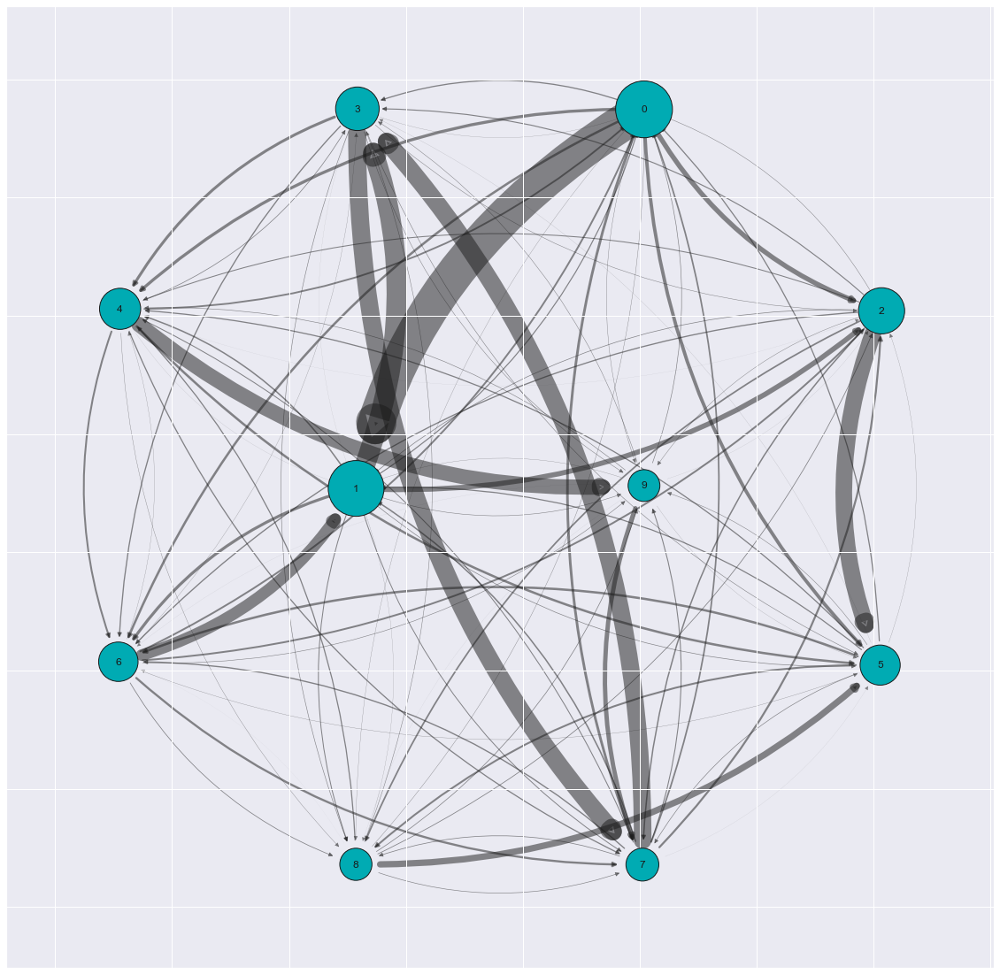

In [109]:
plt.figure(figsize=(20, 20))

nodes_with_term = nx.draw_networkx_nodes(
    G_cluster, 
    pos, 
    nodelist=nodes,
    node_size=count,
    node_color='#00ABB3',
    node_shape='o',
    alpha=None,
    cmap=None,
    vmin=None,
    vmax=None,
    ax=None,
    linewidths=1.0, 
    edgecolors='k', 
    label=nodes, 
    margins=None
)
nodes_with_term.set_zorder(1)

labels = nx.draw_networkx_labels(G_cluster, pos=pos, labels=dict(zip(nodes, nodes)))

edge_collection = nx.draw_networkx_edges(
    G_cluster, 
    pos,
    edgelist=G_cluster.edges(),
    width=[w/1000 for w in weights],
    edge_color='k',
    style='solid',
    alpha=0.5,
    arrowstyle=None,
    arrowsize=10,
    edge_cmap=None,
    edge_vmin=None,
    edge_vmax=None,
    ax=None,
    arrows=None,
    label=None, # weights
    node_size=3000, # count
    nodelist=None,
    node_shape='o',
    connectionstyle='arc3,rad=0.2',
    min_source_margin=0,
    min_target_margin=0,
)

for c in edge_collection:
    c.set_zorder(-1)

# edge_labels = nx.draw_networkx_edge_labels(G_cluster, pos=pos, edge_labels=dict(zip(list(zip(us, vs)), weights)))

plt.show()

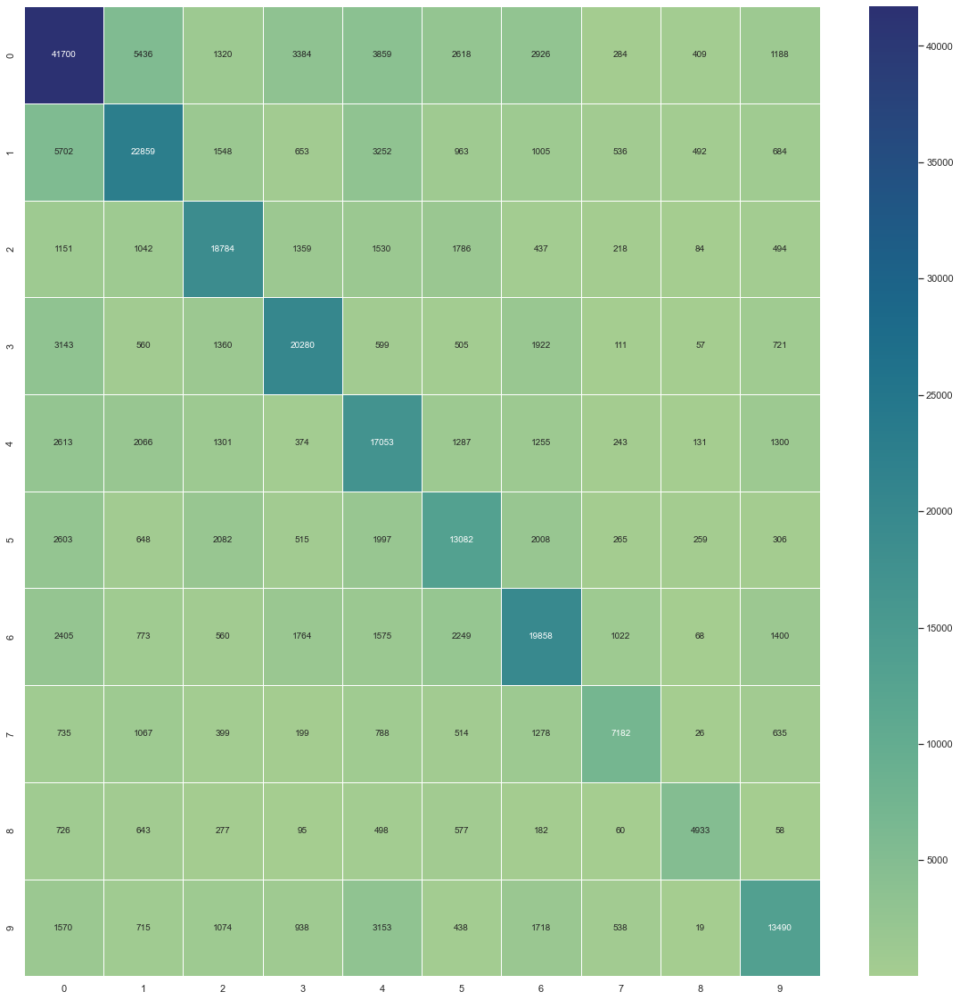

In [133]:
e = np.array(edges)

us = np.unique(e[:,0])
vs = e[:n_communities,1]

weights = e[:,2]
m = weights.reshape((n_communities, n_communities))
# m = np.log(m)

# mask = np.diag(m)

plt.figure(figsize=(20, 20))
sns.heatmap(m, annot=True, linewidth=.5, cmap="crest", xticklabels=us, yticklabels=vs, fmt='g')
plt.show()

In [129]:

vals_refs = e[:,2]
vals_tfidf = similarity.flatten()

np.corrcoef(vals_refs, vals_tfidf)

array([[1.        , 0.62390746],
       [0.62390746, 1.        ]])

In [32]:
import itertools
from collections import Counter

df = corpus.most_referenced(10)

texts = df.select([
    pl.col('Doi'), 
    pl.col('Text').str.split(' ')
]).explode(['Text']).get_column('Text').to_list()

nodes = set(texts)

edges = itertools.combinations(texts, 2)
edges_count = Counter(edges)
filtered_count = list(filter(lambda x: (x[1] > 100) & (x[0][0] != x[0][1]), list(edges_count.items())))

weighted_edges = [(*k, v) for k, v in filtered_count]


G_terms = nx.Graph()
G_terms.add_nodes_from(nodes)
G_terms.add_weighted_edges_from(weighted_edges)

Gcc = sorted(nx.connected_components(G_terms), key=len, reverse=True)
G_terms = G_terms.subgraph(Gcc[0])

nodes = list(G_terms.nodes())

node_sizes = dict(nx.degree_centrality(G_terms))

print(f'Nodes: {len(G_terms.nodes())} Edges: {len(G_terms.edges())}')

Nodes: 22 Edges: 37


In [33]:
pos = nx.nx_pydot.graphviz_layout(G_terms, prog="fdp") # dot, twopi, fdp, sfdp, circo

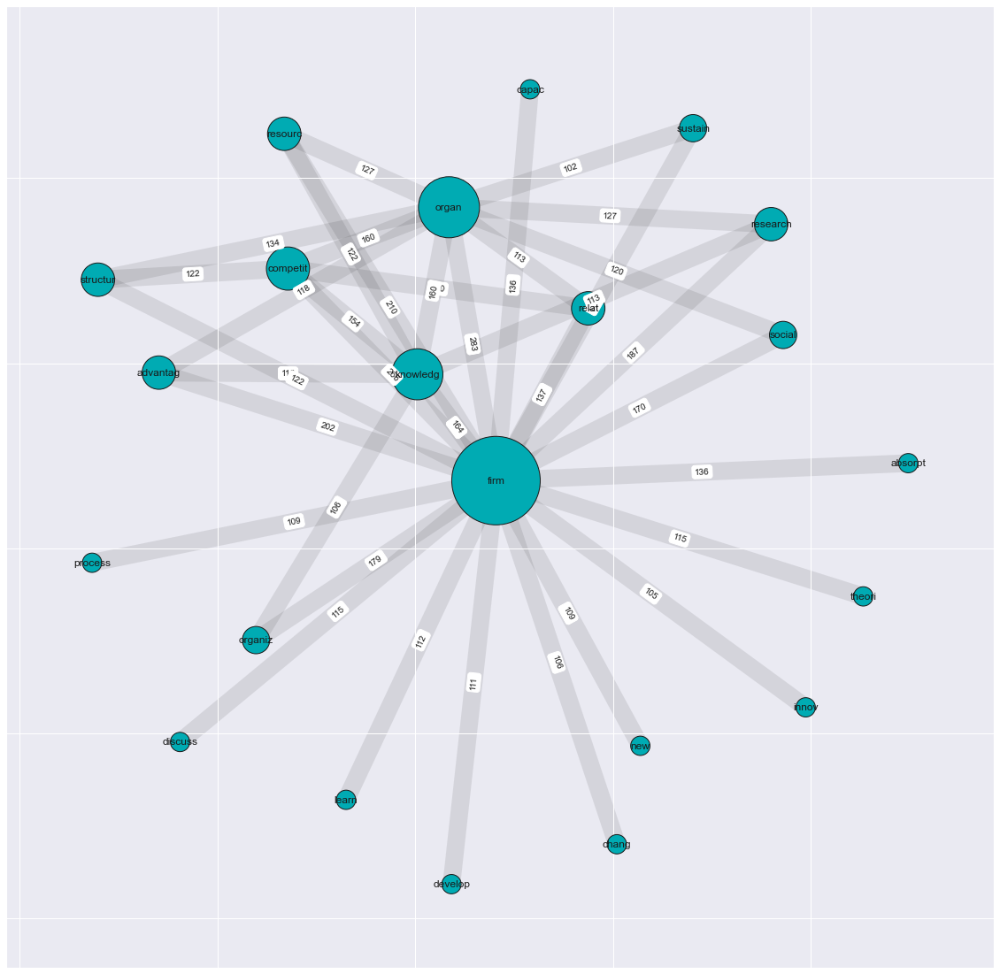

In [34]:
plt.figure(figsize=(20, 20))

nodes_with_term = nx.draw_networkx_nodes(
    G_terms, 
    pos, 
    nodelist=nodes,
    node_size=[s * 10_000 for s in node_sizes.values()],
    node_color='#00ABB3',
    node_shape='o',
    alpha=None,
    cmap=None,
    vmin=None,
    vmax=None,
    ax=None,
    linewidths=1.0, 
    edgecolors='k', 
    label=nodes, 
    margins=None
)
nodes_with_term.set_zorder(1)

labels = nx.draw_networkx_labels(G_terms, pos=pos, labels=dict(zip(nodes, nodes)))

edge_collection = nx.draw_networkx_edges(
    G_terms, 
    pos,
    edgelist=None, # [k for k, v in edges_count.items() if (v >= 100) & (k[0] != k[1])],
    width=20,
    edge_color='k',
    style='solid',
    alpha=0.1,
    arrowstyle='solid',
    arrowsize=10,
    edge_cmap=None,
    edge_vmin=None,
    edge_vmax=None,
    ax=None,
    arrows=None,
    label=None, # weights
    node_size=1000, # count
    nodelist=None,
    node_shape='o',
    connectionstyle='arc3, rad=0.2',
    min_source_margin=0,
    min_target_margin=0,
)

edge_collection.set_zorder(-1)

edge_labels = nx.draw_networkx_edge_labels(G_terms, pos=pos, edge_labels=dict(filtered_count))

plt.show()

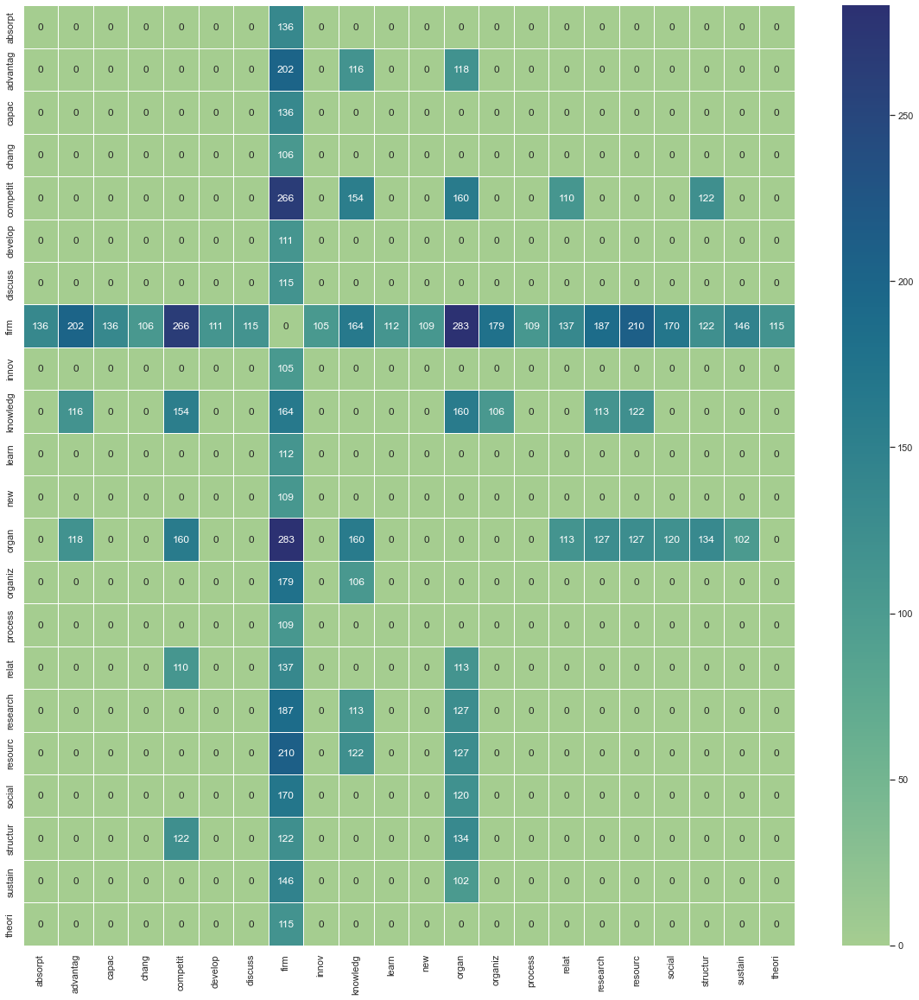

In [87]:
n = sorted(list(G_terms.nodes()))
m = nx.to_numpy_matrix(G_terms, n)
# na = np.isnan(m)
# m[na] = 0

plt.figure(figsize=(20, 20))
# mask = np.triu(m)
sns.heatmap(m, annot=True, linewidth=.5, cmap="crest", xticklabels=n, yticklabels=n, fmt='g') # , mask=mask
plt.show()

In [ ]:
n_communities = 10

df = corpus.citation_df.groupby(pl.col('Community')).agg([pl.col('Text')]).sort(pl.col('Community'))[:n_communities]

communities = df.get_column('Community').to_list()
corpus_ = df.get_column('Text').arr.join(' ').to_list()

tv = TfidfVectorizer(min_df=0.,
                     max_df=1.,
                     norm='l2',
                     use_idf=True,
                     smooth_idf=True)

tv_matrix = tv.fit_transform(corpus_)

tv_matrix = tv_matrix.toarray()

vocab = tv.get_feature_names()

In [ ]:
df = corpus.citation_df

q = (
    df.lazy()
        .select(['Doi', 'References'])
        .explode(['References'])
        # .groupby(['Doi', 'References'])
        # .agg([pl.col('Doi').alias('ReferenceDoi')])
)

q = q.collect()

In [ ]:
df = pl.DataFrame(tv_matrix, columns=vocab)
df = df.transpose(include_header=True, header_name='term', column_names=[str(c) for c in communities])
df.head(4)

In [135]:
z = [squish(A=1, K=300, C=1, Q=325, B=0.04, t=t, v=1) for t in edges_count.values()]
max(z)

299.78051372604244

In [133]:
import numpy as np

def squish(A, K, C, Q, B, t, v):
    '''
    A: the lower (left) asymptote;
    K: the upper (right) asymptote when C=1. If A=0 and C=1 then K is called the carrying capacity
    B: the growth rate
    v > 1: affects near which asymptote maximum growth occurs
    Q: is related to the value Y(0)
    C: typically takes a value of 1. Otherwise, the upper asymptote is A + ((K - A) / (C^(1/v)))
    '''
    x = K - A
    y = np.power(C + Q * np.exp(-B*t), 1/v)
    return A + (x / y)

In [130]:
min_val = min(edges_count.values())
max_val = max(edges_count.values())

print(min_val, max_val)

x = np.arange(min_val, max_val, 1)

y = squish(A=1, K=300, C=1, Q=max_val, B=0.04, t=x, v=1)

import plotly.express as px
fig = px.scatter(x=x, y=y)
fig.show()

1 325


In [130]:
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np

n = 10

# rendering
fig = plt.figure(1); plt.clf()
# compute a grid size that will fit all graphs on it (couple blanks likely)
nr = int(np.ceil(np.sqrt(n)))
fig, ax = plt.subplots(nr, nr, num=1)

for i in range(n):
    
    G = nx.random_tree(10)

    pos = nx.nx_pydot.graphviz_layout(G_cluster, prog="sfdp") # dot, twopi, fdp, sfdp, circo

    plt.sca(ax[ix])

    nx.draw_networkx_nodes(G, pos, ax=ax[ix])
    nx.draw_networkx_edges(G, pos, width=widths, ax=ax[ix],)

    ax[ix].set_title(titles[k], fontsize=10)
    ax[ix].set_axis_off()

plt.show()

NameError: name 'xrange' is not defined

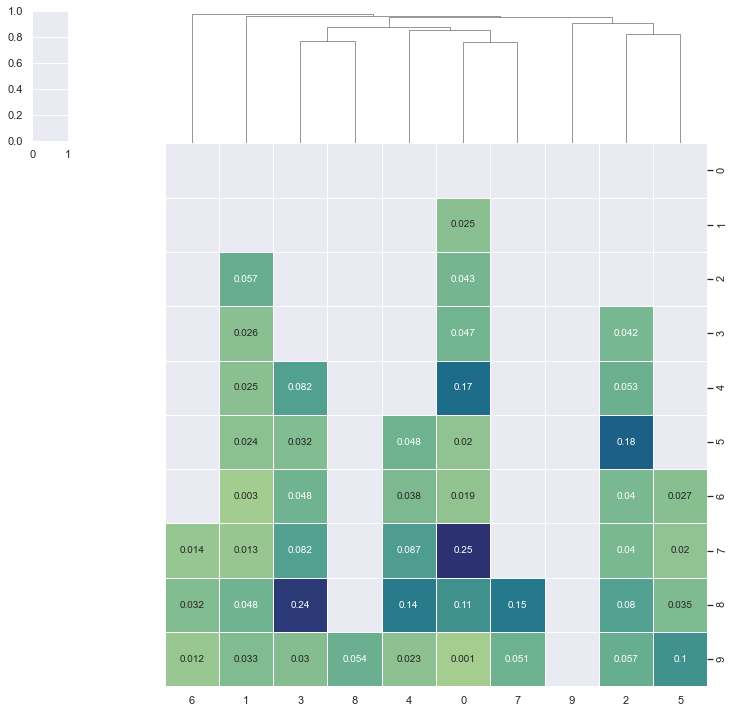

In [44]:
mask = np.triu(similarity)



sns.clustermap(similarity, method="single", annot=True, linewidth=.5, cmap='crest', row_cluster=False, mask=mask, figsize=(10, 10), cbar=None)

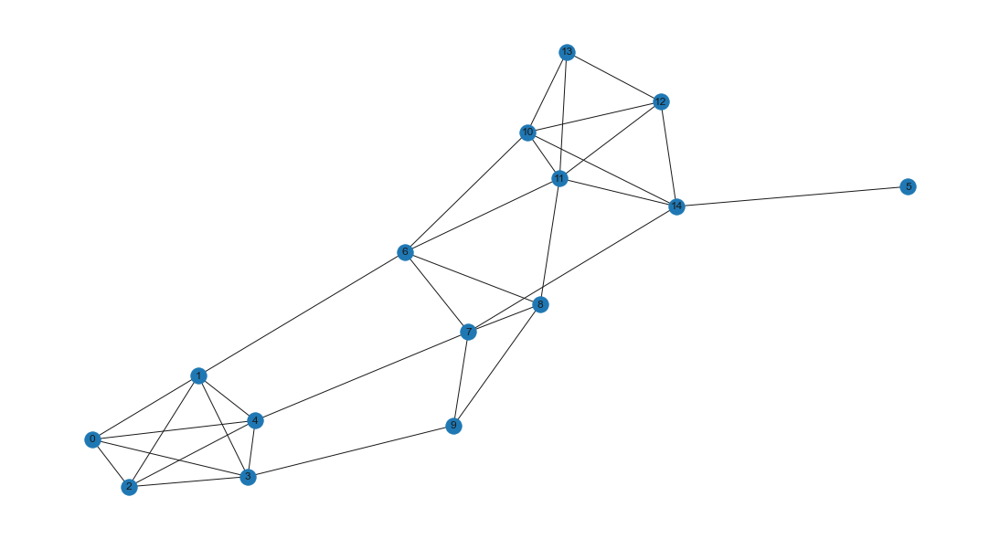

In [111]:
from networkx.algorithms.community import louvain_communities, louvain_partitions, girvan_newman

sizes = [5, 5, 5]
probs = [[0.85, 0.1, 0.05],
         [0.1, 0.8, 0.1],
         [0.05, 0.1, 0.85]]
g = nx.stochastic_block_model(sizes, probs, seed=0)

nx.draw(g, with_labels=True)

In [112]:
partitions = louvain_partitions(g)

In [114]:
next(partitions)
# [{0, 1, 2, 3, 4}, {5, 6, 7, 8, 9}, {10, 11, 12, 13, 14}]

StopIteration: 

In [ ]:
import numpy as np

l = []
for r in np.arange(0.1, 5, 0.1):
    print(f'\r {r}', flush=True, end='')
    com = louvain_communities(g, resolution=r, seed=666)
    l.append(com)

In [6]:
communities = list(girvan_newman(g))
len(communities)

14

In [7]:
from scipy.cluster.hierarchy import linkage
linkage = linkage(communities)

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/scipy/cluster/hierarchy.py:1046: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  y = _convert_to_double(np.asarray(y, order='c'))


In [ ]:
from scipy.cluster.hierarchy import dendrogram
dendrogram(linkage, leaf_rotation=90)

In [3]:
from scipy.cluster.hierarchy import dendrogram, linkage
from matplotlib import pyplot as plt

all_nodes = corpus.most_referenced(10).get_column('Doi').to_list()
G_all = corpus.citation_graph.subgraph(all_nodes)

X = nx.adjacency_matrix(G_all) # nodelist=all_nodes

Z = linkage(X, 'ward')


/var/folders/rz/n4jmlyh1355cy_wkn5gd00x40000gn/T/ipykernel_69265/1562015283.py:7: FutureWarning: adjacency_matrix will return a scipy.sparse array instead of a matrix in Networkx 3.0.
  X = nx.adjacency_matrix(G_all) # nodelist=all_nodes


In [46]:
X

<10x10 sparse matrix of type '<class 'numpy.int64'>'
	with 5 stored elements in Compressed Sparse Row format>

In [47]:
# fig = plt.figure(figsize=(25, 10))
dn = dendrogram(Z)

plt.show()


In [ ]:
tfidf(corpus.citation_df, [])

In [18]:
from itertools import chain

communities = corpus.citation_df.groupby('Community').agg([pl.col('Text').flatten()])
community_ids = communities.get_column('Community').to_list()
community_texts = communities.select(pl.col('Text').arr.join(" ")).get_column('Text').to_list()
communities.head(5)

Community,Text
i32,list[str]
1440,"[""health"", ""well"", ... ""kingdom""]"
88,"[""planning"", ""coordination"", ... ""programming""]"
104,"[""overview"", ""literature"", ... ""efficiency""]"
1456,"[""teaching"", ""effectiveness"", ... ""education""]"
1424,"[""replication"", ""cause"", ... ""judgment""]"


In [19]:
communities = corpus.citation_df.groupby('Community').agg([pl.col('Text').flatten()])
community_ids = communities.get_column('Community').to_list()
community_texts = communities.get_column('Text').to_list()

In [15]:
communities

((320,
  [('apparel', 0.4496828312145546),
   ('sustainability', 0.43708812206868053),
   ('social', 0.31348899180051487),
   ('chain', 0.30839904306427546),
   ('supply', 0.29430802661607985),
   ('global', 0.1369586035833865),
   ('nvivo', 0.1355313968366692),
   ('external', 0.11227326899410345),
   ('satisfactory', 0.10911542898089134),
   ('enrich', 0.10527785907253964),
   ('roadmap', 0.10116505847597851),
   ('labour', 0.09897872997149743),
   ('stakeholder', 0.09634117769540865),
   ('tier', 0.09632448877082944),
   ('sector', 0.08591064028684603),
   ('mitigate', 0.08401482372771195),
   ('entity', 0.08362600211560071),
   ('main', 0.08280386232371037),
   ('represents', 0.07657647292363101),
   ('throughout', 0.0754271214849278),
   ('answer', 0.07432669371257682),
   ('managed', 0.07405875193705554),
   ('definition', 0.07104297066427759),
   ('software', 0.06877343130709321),
   ('achieved', 0.06855706058876883),
   ('analysed', 0.06855706058876883),
   ('carried', 0.067295

In [8]:
import re
from gensim.models import TfidfModel
from gensim.corpora import Dictionary

dct = Dictionary(community_texts)
corpus = [dct.doc2bow(text) for text in community_texts]

model = TfidfModel(corpus)

tfidf = []
for doc in corpus:
    lst = [(dct[id], val) for (id, val) in model[doc]]
    sorted_lst = sorted(lst, key=lambda x: x[1], reverse=True)
    tfidf.append(sorted_lst)

communities = tuple(zip(community_ids, tfidf))

In [14]:
id = 1

print(len())
communities[id]

(1136,
 [('argument', 0.39447899055846186),
  ('environmentalism', 0.3874779800890728),
  ('cohort', 0.3386149912202003),
  ('diffusion', 0.2931982775674675),
  ('postmaterialism', 0.1701392724819787),
  ('postmaterialist', 0.1701392724819787),
  ('proenvironmental', 0.1701392724819787),
  ('environmental', 0.15486354843275),
  ('counterargument', 0.15428606541449186),
  ('concern', 0.14485076400058935),
  ('income', 0.13245603634818479),
  ('diffuses', 0.12563369359067114),
  ('produce', 0.1197859167709253),
  ('adapts', 0.11529618669591049),
  ('affluence', 0.11330611962887079),
  ('null', 0.11330611962887079),
  ('weakening', 0.10978048652318433),
  ('consistent', 0.10957873127274351),
  ('prestige', 0.10533987767897902),
  ('negative', 0.10050695487253691),
  ('relationship', 0.1000241813359899),
  ('weaken', 0.09312469383630556),
  ('occupational', 0.08882368670660658),
  ('standing', 0.08817938091073657),
  ('zero', 0.08694279093619627),
  ('positive', 0.08470278153777448),
  ('s

In [154]:
import numpy as np
import matplotlib.pyplot as plt

barWidth = 0.25

# Set position of bar on X axis
r1 = np.arange(len(bars1))
r2 = [x + barWidth for x in r1]
r3 = [x + barWidth for x in r2]

# Make the plot
plt.bar(r1, bars1, color='#7f6d5f', width=barWidth, edgecolor='white', label='var1')
plt.bar(r2, bars2, color='#557f2d', width=barWidth, edgecolor='white', label='var2')
plt.bar(r3, bars3, color='#2d7f5e', width=barWidth, edgecolor='white', label='var3')
 
# Add xticks on the middle of the group bars
plt.xlabel('group', fontweight='bold')
plt.xticks([r + barWidth for r in range(len(bars1))], ['A', 'B', 'C', 'D', 'E'])
 
# Create legend & Show graphic
plt.legend()
plt.show()

NameError: name 'bars1' is not defined

In [137]:
print(len(model[corpus[5]]))
print(model[corpus[5]])

84
[(23, 0.04014737710706242), (31, 0.03784464431667693), (47, 0.15555802789789688), (58, 0.042133086109204146), (73, 0.0249550163144239), (81, 0.053317418295573536), (124, 0.03736810693546543), (125, 0.037055299197717974), (192, 0.067121768379848), (220, 0.010154244544444385), (248, 0.07700367624613579), (272, 0.04183744980583235), (277, 0.01632669505205784), (286, 0.05799462789745969), (356, 0.005358541968990664), (373, 0.03713305791761411), (377, 0.037526306297516944), (387, 0.019886973852713208), (396, 0.02732515376778055), (448, 0.0467895528659968), (501, 0.05090476384202026), (538, 0.07409246411638029), (583, 0.02565788984114903), (595, 0.1578524976858942), (601, 0.0351300061038674), (739, 0.0347100950368981), (747, 0.048894834286308704), (780, 0.14395961574751182), (853, 0.060040696544101345), (948, 0.08077628430712264), (971, 0.04860851997859635), (1006, 0.12121589831744621), (1063, 0.06403469833365147), (1096, 0.04973763224705937), (1097, 0.052481477552773076), (1111, 0.061859

In [121]:
dct[0]

'accelerating'

In [77]:
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer()
tfidf = vectorizer.fit_transform(community_texts)

In [79]:
tfidf_tokens = vectorizer.get_feature_names()

series_id = pl.Series("Community", community_ids)
df_tfidf = pl.DataFrame(data=tfidf.toarray(), columns=tfidf_tokens)
df_tfidf = df_tfidf.with_column(series_id)

df_tfidf.to_dicts()


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


[{'abandon': 0.0,
  'abandoned': 0.0,
  'abandoning': 0.0,
  'abandonment': 0.0,
  'abandonmenta': 0.0,
  'abate': 0.0,
  'abated': 0.0,
  'abatement': 0.0,
  'abates': 0.0,
  'abating': 0.0,
  'abb': 0.0,
  'abbey': 0.0,
  'abbie': 0.0,
  'abbreviated': 0.0,
  'abc': 0.0,
  'abcd': 0.0,
  'abcp': 0.0,
  'abda': 0.0,
  'abdicate': 0.0,
  'abdicated': 0.0,
  'abduct': 0.0,
  'abducted': 0.0,
  'abduction': 0.0,
  'abductive': 0.0,
  'abductively': 0.0,
  'abell': 0.0,
  'aberdeen': 0.0,
  'aberration': 0.0,
  'abet': 0.0,
  'abets': 0.0,
  'abetting': 0.0,
  'abetweenness': 0.0,
  'abhiyan': 0.0,
  'abi': 0.0,
  'abia': 0.0,
  'abide': 0.0,
  'abiding': 0.0,
  'abiiity': 0.0,
  'abilene': 0.0,
  'ability': 0.0,
  'abilitythe': 0.0,
  'abiotic': 0.0,
  'abis': 0.0,
  'abject': 0.0,
  'able': 0.0,
  'abm': 0.0,
  'abn': 0.0,
  'abnormal': 0.0,
  'abnormality': 0.0,
  'abnormally': 0.0,
  'aboard': 0.0,
  'abolish': 0.0,
  'abolished': 0.0,
  'abolition': 0.0,
  'abolitionism': 0.0,
  'abo

In [71]:
df_tfidf

abandon,abandoned,abandoning,abandonment,abandonmenta,abate,abated,abatement,abates,abating,abb,abbey,abbie,abbreviated,abc,abcd,abcp,abda,abdicate,abdicated,abduct,abducted,abduction,abductive,abductively,abell,aberdeen,aberration,abet,abets,abetting,abetweenness,abhiyan,abi,abia,abide,abiding,...,zhong,zhongguancun,zhu,zhuhai,zhuzhou,ziakas,ziberna,zig,zimbabwe,zimbabwean,zimmerman,zionist,ziop,zip,zipcar,zipf,ziya,zizhu,zmud,zogp,zone,zoned,zoning,zoo,zookeepers,zookeeping,zoom,zooming,zooprofilattico,zorzini,zott,zou,zuckerberg,zuckerman,zuzeviciute,zvezki,zwick
f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,...,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.329081,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


[('business & economics', 25724), ('engineering', 4209), ('sociology', 3529), ('computer science', 2392), ('environmental sciences & ecology', 2348), ('operations research & management science', 2254), ('information science & library science', 2228), ('psychology', 1641), ('social sciences - other topics', 1262), ('science & technology - other topics', 1099)]


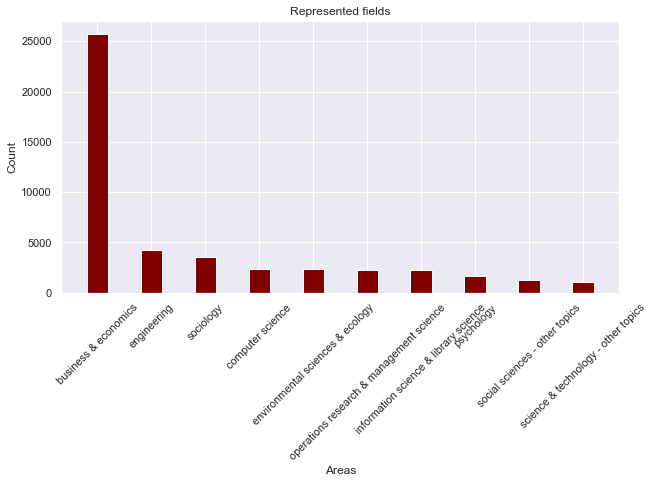

In [5]:
q = (
    df.lazy()
        .select(pl.col("Area").flatten())
        .groupby("Area")
        .agg([pl.count()])
)

q = q.collect()

top = 10

areas = q.get_column("Area").to_list()
values = q.get_column("count").to_list()

ordered_areas = sorted(zip(areas, values), key=lambda x: x[1], reverse=True)

top_ordered_areas = ordered_areas[:top]
print(top_ordered_areas)

# (areas, count) = map(None, *top_ordered_areas)
(areas, counts) = list(zip(*top_ordered_areas))

fig = plt.figure(figsize = (10, 5))

plt.bar(areas, counts, color='', width=0.4)

plt.xlabel("Areas")
plt.ylabel("Count")
plt.title("Represented fields")
plt.xticks(areas, rotation=25)
plt.show()

In [7]:
from networkx.algorithms import community

import os

# Communities


In [8]:
output_path = './output/organizations/community/'

## 1. Louvain

In [22]:

file_name = 'louvain_communities'

communities = list(community.louvain_communities(g, weight=None))
ids = list(range(len(communities)))
data = [
    pl.Series("id", ids, dtype=pl.Int32),
    pl.Series("community", communities, dtype=pl.List),
]

df = pl.DataFrame(data)

if not os.path.exists(output_path):
    os.makedirs(output_path)
df.write_parquet(output_path + file_name + '.parquet')


## 2. Greedy

In [33]:
file_name = 'greedy_modularity_communities'

communities = community.greedy_modularity_communities(g)

if not os.path.exists(output_path):
    os.makedirs(output_path)
with open(output_path + file_name + '.txt', "w") as f:
    for c in communities:
        f.write(",".join(c) + '\n')

## 3. Label Propagation

In [34]:

file_name = 'undirected_label_propagation_communities'

undirected_g = g.to_undirected()
communities = community.label_propagation_communities(undirected_g)

if not os.path.exists(output_path):
    os.makedirs(output_path)
with open(output_path + file_name + '.txt', "w") as f:
    for c in communities:
        f.write(",".join(c) + '\n')

In [271]:
g = Citation('../output/adjlist.txt')


        Nodes: 29073
        Edges: 256517
        


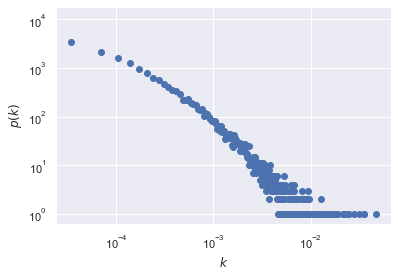

In [274]:
g.edge_dist('in')

In [241]:
t = list(dict(sorted(nx.in_degree_centrality(g).items(), key=lambda c: c[1], reverse=True)).keys())[20]
print(t)
df.select([
    pl.col("Authors").filter(pl.col("Doi") == t)
])


10.1002/smj.4250171108


Authors
list[str]
"[""mowery"", ""oxley"", ""silverman""]"


In [73]:
len(g.edges())

349514

In [71]:
from collections import defaultdict
import random
import numpy as np
from networkx.drawing.nx_pydot import graphviz_layout


In [64]:
rand_range = lambda n: range(random.randint(0, n))

{1, 2, 3, 4, 5, 6, 7, 8, 9, 10}


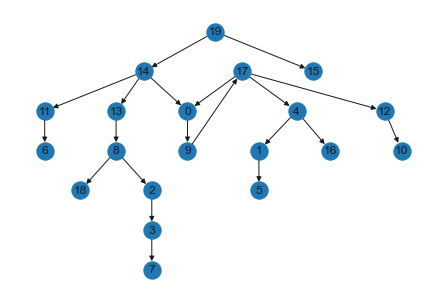

In [111]:
def get_tree(S):
    n = len(S)
    L = set(range(1, n+2+1))
    print(L)
    tree_edges = []
    for i in range(n):
        # print('L', L)
        # print('S', set(S))
        # print(L - set(S))
        u, v = S[0], min(L - set(S))
        S.pop(0)
        L.remove(v)
        tree_edges.append((u,v))
    
    tree_edges.append((L.pop(), L.pop()))
    return tree_edges

n = 10
S = np.random.choice(range(1,n+1), n-2, replace=True).tolist()
# print(S)
# print(len(S))
edges = get_tree(S)

edges = [(17, 0), (1, 5), (4, 1), (11, 6), (3, 7), (2, 3), (8, 2), (12, 10), (14, 11), (17, 12), (19, 15), (4, 16), (17, 4), (9, 17), (0, 9), (14, 0), (8, 18), (13, 8), (14, 13), (19, 14)]

G = nx.DiGraph()
G.add_edges_from(edges)
pos = pos = nx.nx_pydot.graphviz_layout(G, prog="dot") # dot, twopi, fdp, sfdp, circo
nx.draw(G, pos, with_labels=True)
plt.show()


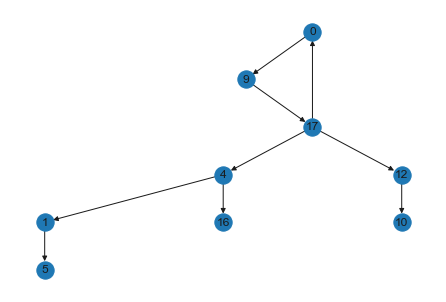

In [120]:
root = 17
descendants = nx.descendants(G, root)
descendants.add(root)
G_descendants = G.subgraph(descendants)

pos = nx.nx_pydot.graphviz_layout(G_descendants, prog="dot") # dot, twopi, fdp, sfdp, circo
nx.draw(G_descendants, pos, with_labels=True)
plt.show()

In [116]:
m = defaultdict(list)

m[0] = []

for c in rand_range(3):

    
    # for c1 in rand_range(3):

    m[0].append(c)

m

defaultdict(list, {0: []})

In [ ]:
def build(n):
    

In [59]:
t = Tree()
t.build()

In [60]:
t.tree

defaultdict(list,
            {0: [],
             1: [],
             2: [],
             3: [],
             4: [],
             5: [],
             6: [],
             7: [],
             8: [],
             9: [],
             10: [],
             11: [],
             12: [],
             13: [],
             14: [],
             15: [],
             16: [],
             17: [],
             18: [],
             19: [],
             20: [],
             21: [],
             22: [],
             23: [],
             24: [],
             25: [],
             26: [],
             27: [],
             28: [],
             29: [],
             30: [],
             31: [],
             32: [],
             33: [],
             34: [],
             35: [],
             36: [],
             37: [],
             38: [],
             39: [],
             40: [],
             41: [],
             42: [],
             43: [],
             44: [],
             45: [],
             46: [],
     

In [175]:
import polars as pl

df = pl.DataFrame(
    [
        pl.Series("ID", ["A", "B", "C", "D", "E"], dtype=pl.Utf8),
        pl.Series("EDGES", [["B", "C"], ["D", "1"], ["E", "2"], ["E", "A"], ["D", "A"]], dtype=pl.List),
    ]    
)

df.with_column(pl.col('EDGES').list().filter(pl.col('EDGES').explode().is_in(pl.col('ID'))).alias('TRY'))

thread '<unnamed>' panicked at 'range end index 4 out of range for slice of length 2', library/core/src/slice/index.rs:73:5


PanicException: range end index 4 out of range for slice of length 2

In [294]:
import polars as pl
exclude_fruit = ["apple", "orange"]

df = pl.DataFrame(
    [
        pl.Series("ID", ["A", "B", "C", "D", "E"], dtype=pl.Utf8),
        pl.Series("EDGES", [["B", "C", "X"], ["D", "X"], ["E", "Y"], ["E", "A"], ["D", "A", "Z"]], dtype=pl.List),
    ]    
)

df1 = df.explode("EDGES").filter(pl.col('EDGES').is_in(pl.col('ID'))).groupby('ID').agg_list()

df = df1.join(df, on='ID', how='semi')

df

ID,EDGES
str,list[str]
"""B""","[""D""]"
"""D""","[""E"", ""A""]"
"""C""","[""E""]"
"""E""","[""D"", ""A""]"
"""A""","[""B"", ""C""]"


In [281]:

# df.with_column(pl.col('EDGES').apply(lambda l: l + "P").alias('HAS2'))
# df.with_column(pl.col('EDGES').arr.filter(pl.col('EDGES_TT')).alias('HAS2'))

# df.select(pl.col('EDGES').explode().list())


# df.select(
#     pl.col('EDGES')
#         .explode()
#         .filter(pl.col('EDGES').explode().is_in(pl.col('ID')))
#         # .groupby('ID')
#         # .agg_list()
#     # .alias(['ID2', 'EDGES2'])
# )

In [282]:
# df.select(pl.col('EDGES').apply(lambda x: x.is_in(pl.col('ID'))))